## Importing neccesary libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statistics
import seaborn as sns
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.express as px
import requests
import os
for dirname, _, filenames in os.walk('/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
%matplotlib inline
!pip install mplcyberpunk
import plotly.graph_objects as go
from plotly.subplots import make_subplots
palette = ['#F5DF4D', '#939597', '#0F4C81', '#FF6F61', '#5F4B8B', '#88B04B', '#92A8D1', '#F7CAC9', '#955251',\
           '#B163A3', '#009473']
palette.reverse()

## Importing data, simple preliminary analysis 

In [2]:
import os
for dirname, _, filenames in os.walk('/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

### Little modification for Hyundai data
Hyundai dataset contains a column which includes pound sign before the 'tax' column.  
We need to delete it first before merging

In [3]:
df_hyundi = pd.read_csv('data/hyundi.csv')
df_hyundi.head()

,model,year,price,transmission,mileage,fuelType,tax(£),mpg,engineSize
0,I20,2017,7999,Manual,17307,Petrol,145,58.9,1.2
1,Tucson,2016,14499,Automatic,25233,Diesel,235,43.5,2.0
2,Tucson,2016,11399,Manual,37877,Diesel,30,61.7,1.7
3,I10,2016,6499,Manual,23789,Petrol,20,60.1,1.0
4,IX35,2015,10199,Manual,33177,Diesel,160,51.4,2.0


### Columns deleted

In [4]:
df_hyundi = df_hyundi.drop(columns={'tax(£)': 'tax'})
df_hyundi.head()

,model,year,price,transmission,mileage,fuelType,mpg,engineSize
0,I20,2017,7999,Manual,17307,Petrol,58.9,1.2
1,Tucson,2016,14499,Automatic,25233,Diesel,43.5,2.0
2,Tucson,2016,11399,Manual,37877,Diesel,61.7,1.7
3,I10,2016,6499,Manual,23789,Petrol,60.1,1.0
4,IX35,2015,10199,Manual,33177,Diesel,51.4,2.0


## Merging all data sets to one big full_data dataset:

In [5]:
# This will get the names of the files in the dataset's folder
files = [file for file in os.listdir('data/')]
full_data = pd.DataFrame()

for file in files:
    if file in ['hyundi.csv', 'unclean focus.csv', 'unclean cclass.csv']:
        continue
    df = pd.read_csv('data/'+file)
    full_data = pd.concat([full_data, df])

full_data = pd.concat([full_data, df_hyundi])
print(full_data.head())

  model  year  price transmission  mileage fuelType    tax   mpg  engineSize
0    A1  2017  12500       Manual    15735   Petrol  150.0  55.4         1.4
1    A6  2016  16500    Automatic    36203   Diesel   20.0  64.2         2.0
2    A1  2016  11000       Manual    29946   Petrol   30.0  55.4         1.4
3    A4  2017  16800    Automatic    25952   Diesel  145.0  67.3         2.0
4    A3  2019  17300       Manual     1998   Petrol  145.0  49.6         1.0


In [6]:
model_count=full_data
ax2= px.treemap(model_count,path=["model"],title="Popularity of the bought car models:")
ax2.show()

## Preliminary statistical analisys:

In [7]:
print(full_data.describe())

                year          price        mileage           tax  \
count  108540.000000  108540.000000  108540.000000  94327.000000   
mean     2017.098028   16890.124046   23025.928469    120.256183   
std         2.130057    9756.266820   21176.423684     63.404805   
min      1970.000000     450.000000       1.000000      0.000000   
25%      2016.000000   10229.500000    7491.750000    125.000000   
50%      2017.000000   14698.000000   17265.000000    145.000000   
75%      2019.000000   20940.000000   32236.000000    145.000000   
max      2060.000000  159999.000000  323000.000000    580.000000   

                mpg     engineSize  
count  99187.000000  108540.000000  
mean      55.166825       1.661644  
std       16.138522       0.557058  
min        0.300000       0.000000  
25%       47.100000       1.200000  
50%       54.300000       1.600000  
75%       62.800000       2.000000  
max      470.800000       6.600000  


In [8]:
full_data=full_data[full_data.year != 2060]

In [9]:
full_data.shape

(108539, 9)

In [10]:
print(full_data.columns)

Index(['model', 'year', 'price', 'transmission', 'mileage', 'fuelType', 'tax',
       'mpg', 'engineSize'],
      dtype='object')


In [11]:
print(full_data.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 108539 entries, 0 to 4859
Data columns (total 9 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   model         108539 non-null  object 
 1   year          108539 non-null  int64  
 2   price         108539 non-null  int64  
 3   transmission  108539 non-null  object 
 4   mileage       108539 non-null  int64  
 5   fuelType      108539 non-null  object 
 6   tax           94326 non-null   float64
 7   mpg           99186 non-null   float64
 8   engineSize    108539 non-null  float64
dtypes: float64(3), int64(3), object(3)
memory usage: 8.3+ MB
None


In [12]:
full_data.isna().any()

model           False
year            False
price           False
transmission    False
mileage         False
fuelType        False
tax              True
mpg              True
engineSize      False
dtype: bool

## Calculations

 ### Calculating which models are most popular:

Calculate total amount of the sales for each model:

In [13]:
import mplcyberpunk

            Buys
model           
 Focus     10042
 C Class    7646
 Fiesta     6556
 Golf       4863
 Corsa      3441
 Polo       3287
 Astra      2805
 A Class    2561
 3 Series   2443
 Kuga       2225


<AxesSubplot:xlabel='model'>

<Figure size 720x432 with 0 Axes>

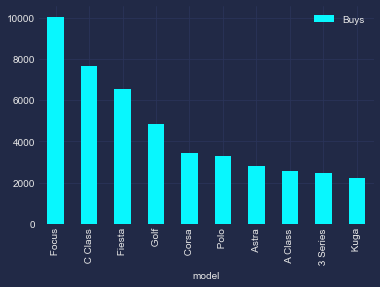

In [14]:
gry=full_data
model_buys= gry.groupby('model')['model'].count()
model_buys = pd.DataFrame(model_buys)
model_buys.columns = ['Buys']
model_buys.sort_values(by=['Buys'], inplace=True, ascending=False)
model_buys = model_buys.head(10)
print(model_buys.head(20))
plt.figure(figsize=(10,6))
plt.style.use("cyberpunk")
model_buys.plot.bar()

### Conclusion

As we can see in the UK the most popular car models are Focus, C Class and Fiesta.  
It is clearly visable that Ford cars are the kings of the roads

### Checking the year from which cars are the most popular:

In [15]:
gry=full_data
model_buys1= gry.groupby('year')['model'].count()
model_buys1 = pd.DataFrame(model_buys1)
model_buys1.columns = ['Buys']
model_buys1.sort_values(by=['Buys'], inplace=True, ascending=False)
model_buys1 = model_buys1.head(10)
print(model_buys1.head(20))

       Buys
year       
2019  29955
2017  23686
2016  16948
2018  15092
2015   8359
2020   4657
2014   4377
2013   2818
2012    702
2011    477


<AxesSubplot:xlabel='year'>

<Figure size 720x432 with 0 Axes>

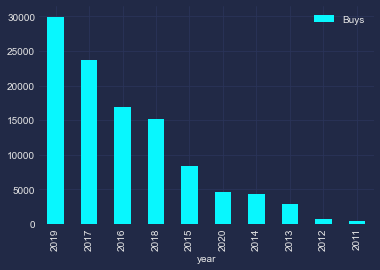

In [16]:
plt.figure(figsize=(10,6))
plt.style.use("cyberpunk")
model_buys1.plot.bar()

### Conclusion:

As we can see in the UK the most popular car year is 2019.  
People rather buy cars that are from the last 4 years than a brand new vechicle

### Checking the average price of cars regarding their year of registration

In [17]:
model_buys2=full_data
model_buys2=model_buys2[["price","year"]].groupby('year').mean()
model_buys2.sort_values(by=['price'], inplace=True, ascending=False)
model_buys2 = model_buys2.head(10)
print(model_buys2.head(20))

             price
year              
2020  28517.838737
2019  23535.764814
1970  17747.000000
2018  16310.332229
2017  14463.352022
2016  13374.278322
2015  11655.549587
2014   9998.366690
2013   8539.841732
2012   7520.623932


Text(0.5, 37.5, 'Model price')

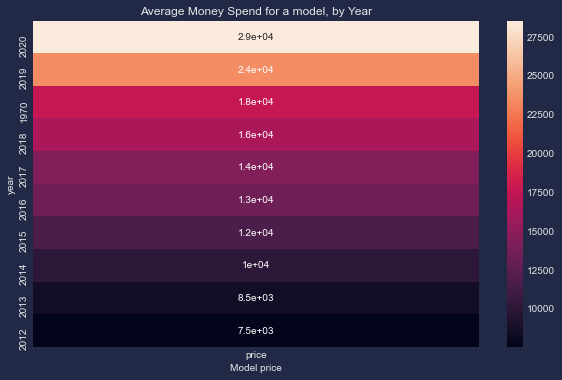

In [18]:
plt.figure(figsize=(10,6))

# Add title
plt.title("Average Money Spend for a model, by Year")

# Heatmap showing average arrival delay for each airline by month
sns.heatmap(data=model_buys2, annot=True)
# Add label for horizontal axis
plt.xlabel("Model price")

### Conclusion:

As we could be sure that the newer cars prices would be the most expensive per one, it is interesting that the classic cars from 1970 year have the higher price then cars from 2018 and 2017 year

### Let's check which transmission is more popular

In [19]:
model_trans=gry
model_trans= model_trans.groupby('transmission')['model'].count()
print(model_trans.head(20))

transmission
Automatic    22318
Manual       61308
Other           10
Semi-Auto    24903
Name: model, dtype: int64


As we can see the most of the bought cars have manual gearbox

### Visualization of the transmissions:

In [20]:
model_trans=full_data
model_trans=full_data
model_trans=model_trans[model_trans.year != 1970]
model_trans=model_trans[model_trans.year != 1991]

model_trans3 = model_trans[model_trans.transmission == "Automatic"]
model_trans3= model_trans.groupby('year')['model'].count()

print(model_trans3.head(50))

year
1995        1
1996        2
1997        4
1998        9
1999        6
2000        9
2001       20
2002       36
2003       39
2004       55
2005       84
2006       92
2007      185
2008      233
2009      321
2010      369
2011      477
2012      702
2013     2818
2014     4377
2015     8359
2016    16948
2017    23686
2018    15092
2019    29955
2020     4657
Name: model, dtype: int64


In [21]:
model_trans2=full_data
model_trans2 = model_trans2[model_trans2.transmission == "Manual"]
model_trans2= model_trans2.groupby('year')['model'].count()

In [22]:
model_trans4=full_data
model_trans4 = model_trans4[model_trans4.transmission == "Semi-Auto"]
model_trans4= model_trans4.groupby('year')['model'].count()

 ### Manual vs Automatic:

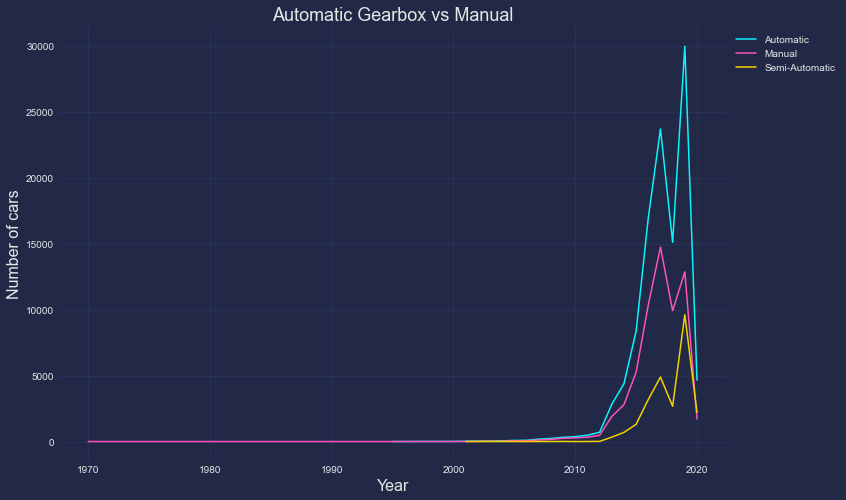

In [23]:
plt.style.use("cyberpunk")
# plot out the time series 
model_trans3.plot(kind = 'line', label = 'Automatic', figsize = (12, 8))
model_trans2.plot(kind = 'line', label = 'Manual', figsize = (12, 8))
model_trans4.plot(kind = 'line', label = 'Semi-Automatic', figsize = (12, 8))
plt.title('Automatic Gearbox vs Manual', fontsize = 18)
plt.xlabel('Year', fontsize = 16)
plt.ylabel('Number of cars', fontsize = 16)
plt.legend(loc='upper left', bbox_to_anchor=(1,1), ncol=1);

### Conclusion:

As we can see the most of the bought cars have manual gearbox but the trend changes and more and more people are interested in cars with automatic gearbox

 ### Let's check which fuel type is more popular

In [24]:
model_fuel=gry
model_fuel= model_fuel.groupby('fuelType')['model'].count()
print(model_fuel.head(20))

fuelType
Diesel      45177
Electric        6
Hybrid       3229
Other         253
Petrol      59874
Name: model, dtype: int64


As we can see the most of the bought cars are Diesel

### Visualization of the fuel types:

In [25]:
model_fuel1=full_data
model_fuel2=full_data
model_fuel3=full_data
model_fuel4=full_data

model_fuel=full_data
model_fuel=model_fuel[model_fuel.year != 1970]
model_fuel=model_fuel[model_fuel.year != 1991]

model_fuel1=model_fuel1[model_fuel1.year != 1970]
model_fuel1=model_fuel1[model_fuel1.year != 1991]

model_fuel1 = model_fuel1[model_fuel1.fuelType == "Diesel"]
model_fuel1= model_fuel1.groupby('year')['model'].count()

model_fuel2 = model_fuel2[model_fuel2.fuelType == "Electric"]
model_fuel2= model_fuel2.groupby('year')['model'].count()

model_fuel3 = model_fuel3[model_fuel3.fuelType == "Hybrid"]
model_fuel3= model_fuel3.groupby('year')['model'].count()

model_fuel4 = model_fuel4[model_fuel4.fuelType == "Petrol"]
model_fuel4= model_fuel4.groupby('year')['model'].count()

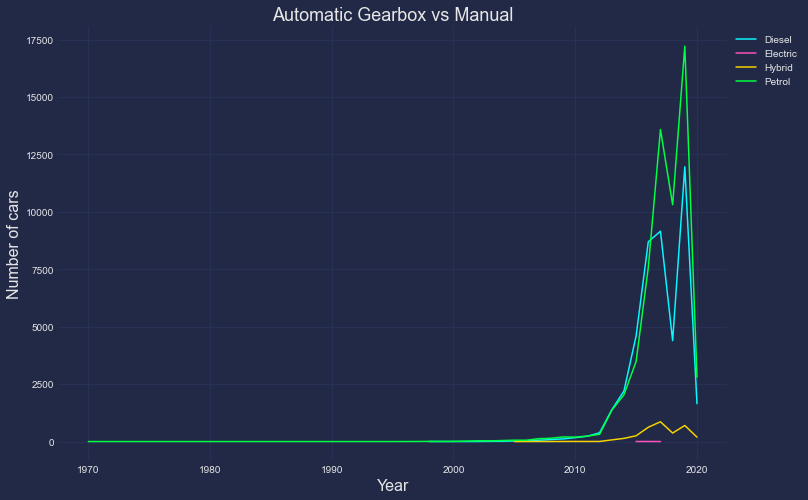

In [26]:
plt.style.use("cyberpunk")
# plot out the time series 
model_fuel1.plot(kind = 'line', label = "Diesel", figsize = (12, 8))
model_fuel2.plot(kind = 'line', label = "Electric", figsize = (12, 8))
model_fuel3.plot(kind = 'line', label = "Hybrid", figsize = (12, 8))
model_fuel4.plot(kind = 'line', label = "Petrol", figsize = (12, 8))
plt.title('Automatic Gearbox vs Manual', fontsize = 18)
plt.xlabel('Year', fontsize = 16)
plt.ylabel('Number of cars', fontsize = 16)
plt.legend(loc='upper left', bbox_to_anchor=(1,1), ncol=1);

### Conclusion:

In the last year the number of cars that are hybrid is increasing also we can see some electric cars  
Number of cars with Diesel Engine also is higher which can be caused by the creation of new high performance diesel engines that are really good for long rides

## Investigation over the price changes:

In [27]:
plt.style.use("cyberpunk")
dfer= full_data
dfmer= full_data
dfwil= full_data
drai=full_data
dfer =dfer.sort_values('mpg', ascending=False)
dfmer =dfmer.sort_values('engineSize', ascending=False)
dfwil =dfwil.sort_values('tax', ascending=False)
drai =drai.sort_values('mileage', ascending=False)
fig = make_subplots(rows=2, cols=2)
fig.add_trace(go.Scatter(x=dfer['mpg'], y=dfer['price'], name="Miles Per Galon"),row=1, col=1)
fig.add_trace(go.Scatter(x=dfmer['engineSize'], y=dfmer['price'], name="Engine Size"),row=1, col=2)
fig.add_trace(go.Scatter(x=dfwil['tax'], y=dfwil['price'], name="Tax"),row=2, col=1)
fig.add_trace(go.Scatter(x=drai['mileage'], y=dfwil["price"], name="Mileage"),row=2, col=2)
fig.update_layout(height=600, width=650, title_text="What the price depends on?")
fig.show()
plt.style.use("cyberpunk")

### Conclusion:

Most of the cars are in the first interval to 100 miles per gallon  

The highest price is also the biggest for the smallest amount of mpg but we need to include that it is also connected with the engine size  

We have checked the tax amount and the clear corelation is not visable with the year,mgp or engine size. This is happening because the amount regards the carbon emissions of the car in UK.  

Smaller amount of mileage also makes the price bigger

## Final Conclusion:

As we can see the most popular models in the UK are Ford Focus, Mercedes C Class and Ford Fiesta. It is easly seen that the favourite car brand in the United Kingdom is Ford.  

The most cars have been bought from the last 3-4 years.  

Most of the cars have manual gearbox.  

Petrol is the most popular fuel type.  

The price depends on so many things that is really hard to clarify the biggest price change reason.We can for sure say that the price is higher when the car uses smaller amount of miles per galon and has a smaller mileage. The tax is not a good criterium beacuse in UK it depends on the CO2 emission.